# LDA project

# Imports and helpfunctions

In [1]:
# imports
import numpy as np
import csv
import glob
import pandas as pd
import spacy

# gensim for topic modeling
import gensim
import gensim.corpora as corpora
from gensim.utils import simple_preprocess
from gensim.models import CoherenceModel

# vis
import pyLDAvis
import pyLDAvis.gensim

In [2]:
def formatText(text):
    # Help function to remove brackets and quotes
    cleaned_text = text.replace('[', "").replace("]", "").replace("'", "").replace(",", "")
    return cleaned_text.strip()

def lemmatizeText(textArray, posTags=["NOUN", "ADJ", "VERB", "ADV"]):
    nlp = spacy.load("en_core_web_sm", disable=["parser","ner"])
    lemmatizedOutput = []
    for text in textArray:
        formatted = formatText(text)
        doc = nlp(formatted)
        """
        for token in doc:
            print(token.text, token.pos_, token.tag_)
            """
        lemmatizedSentence = [token.lemma_ for token in doc if token.pos_ in posTags]        
        lemmatizedOutput.append(lemmatizedSentence)
    return lemmatizedOutput



# Positive Reviews

In [10]:
dataFramePositive = pd.read_csv('./datasets/positive_reviews.csv')
positiveReviews = dataFramePositive['review_text']

In [11]:
positiveReviewsWords = lemmatizeText(positiveReviews)

KeyboardInterrupt: 

In [7]:
positiveReviewDictionary = corpora.Dictionary(positiveReviewsWords)

def createPositiveCorpus(textReviews):
    corpus = []
    for text in textReviews:
        new =  positiveReviewDictionary.doc2bow(text)
        corpus.append(new)
    return corpus

positiveCorpus= createPositiveCorpus(positiveReviewsWords)

print(positiveReviewDictionary)
print(len(positiveCorpus))

Dictionary(236970 unique tokens: ['beautiful', 'simply', 'ability', 'accompany', 'alone']...)
500490


## Positive reviews: 5 topics, 2 passes

In [8]:
ldaModel_positive = gensim.models.ldamodel.LdaModel(corpus=positiveCorpus, num_topics=5, id2word=positiveReviewDictionary, chunksize=10000, passes=2, alpha="auto")

In [9]:
pyLDAvis.enable_notebook()
visPositive = pyLDAvis.gensim.prepare(ldaModel_positive, positiveCorpus, positiveReviewDictionary, mds="mmds", R=30)
visPositive

/Users/carolinadexwik/Documents/_Mina_Dokument/EDUCATION/_KTH/Kurser/DM2583 Big Data in Media Technology /DM2583-project-game-reviews/.venv/lib/python3.7/site-packages/pyLDAvis/_prepare.py:248: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  by='saliency', ascending=False).head(R).drop('saliency', 1)


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
4     -0.040673  0.016807       1        1  31.837161
3     -0.074471 -0.218928       2        1  31.092155
1     -0.194951  0.017619       3        1  17.502809
0      0.017247  0.208854       4        1  10.714622
2      0.292849 -0.024353       5        1   8.853252, topic_info=       Term           Freq          Total Category  logprob  loglift
14     game  883701.000000  883701.000000  Default  30.0000  30.0000
69     play  249120.000000  249120.000000  Default  29.0000  29.0000
84    story   90624.000000   90624.000000  Default  28.0000  28.0000
107    good  193301.000000  193301.000000  Default  27.0000  27.0000
261     fun  129327.000000  129327.000000  Default  26.0000  26.0000
..      ...            ...            ...      ...      ...      ...
351    find    4593.434701   45641.462506   Topic5  -5.6770   0.1282
24      not    5488.096294  371237.791616   Topic5  -5.4990  -1.7899
167    come    4354.163266   37272.116578   Topic5  -5.7305   0.2773
339  people    4417.266787   45820.199348   Topic5  -5.7161   0.0852
72      see    4160.660898   48885.141028   Topic5  -5.7759  -0.0394

[468 rows x 6 columns], token_table=      Topic      Freq     Term
term                          
2         1  0.896335  ability
2         3  0.019932  ability
2         4  0.022068  ability
2         5  0.061627  ability
494       1  0.154331      act
...     ...       ...      ...
295       4  0.113569     year
295       5  0.003206     year
387       1  0.003260   zombie
387       2  0.567320   zombie
387       5  0.429384   zombie

[1117 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[5, 4, 2, 1, 3])

## Compute Coherence 

In [12]:
def compute_coherence_values(corpus, dictionary, k , p):
    
    lda_model = gensim.models.ldamodel.LdaModel(corpus=corpus,
                                           id2word=dictionary,
                                           num_topics=k, 
                                           random_state=100,
                                           chunksize=10000,
                                           passes=p,
                                           alpha="auto",
                                           )
    
    coherence_model_lda = CoherenceModel(model=lda_model, texts=positiveReviewsWords, dictionary=positiveReviewDictionary, coherence='c_v')
    
    return coherence_model_lda.get_coherence()

In [11]:
import tqdm

# Topics range
min_topics = 2
max_topics = 16
step_size = 1
topics_range = range(min_topics, max_topics, step_size)

model_results = {
                 'Topics': [],
                 'Coherence': [],
                }
    

In [12]:
%%script false

from datetime import datetime

current_datetime = datetime.now()
formatted_datetime = current_datetime.strftime('%Y-%m-%d_%H-%M-%S')


for k in topics_range:
    cv = compute_coherence_values(corpus=positiveCorpus, dictionary=positiveReviewDictionary, k=k, p=2)
    # Save the model results
    model_results['Topics'].append(k)
    model_results['Coherence'].append(cv)

   
pd.DataFrame(model_results).to_csv(f'./results/lda_tuning_results_{formatted_datetime}.csv', index=False)


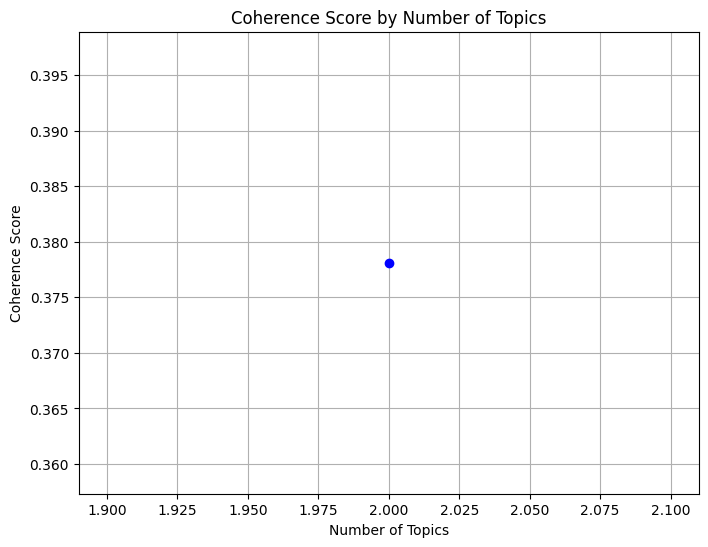

In [13]:
import matplotlib.pyplot as plt

# Load the desired CSV file into a Pandas DataFrame 
df = pd.read_csv('./results/lda_tuning_results.csv')

plt.figure(figsize=(8, 6))  # Set figure size
plt.plot(df['Topics'], df['Coherence'], marker='o', linestyle='-', color='b')

plt.xlabel('Number of Topics')
plt.ylabel('Coherence Score')
plt.title('Coherence Score by Number of Topics')

plt.grid(True)
plt.show()

## Positive reviews: 12 topics, 2 passes

In [14]:
ldaModel_positive_12 = gensim.models.ldamodel.LdaModel(corpus=positiveCorpus, num_topics=12, id2word=positiveReviewDictionary, chunksize=10000, passes=2, alpha="auto")

In [15]:
pyLDAvis.enable_notebook()
visPositive12 = pyLDAvis.gensim.prepare(ldaModel_positive_12, positiveCorpus, positiveReviewDictionary, mds="mmds", R=30)
visPositive12

/Users/carolinadexwik/Documents/_Mina_Dokument/EDUCATION/_KTH/Kurser/DM2583 Big Data in Media Technology /DM2583-project-game-reviews/.venv/lib/python3.7/site-packages/pyLDAvis/_prepare.py:248: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  by='saliency', ascending=False).head(R).drop('saliency', 1)


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
5      0.094558 -0.019533       1        1  31.867408
0      0.199292 -0.190518       2        1  12.158002
6      0.011885 -0.301406       3        1   9.720142
11    -0.141742 -0.264979       4        1   7.933224
3     -0.246612 -0.136489       5        1   7.597016
4      0.068845 -0.177683       6        1   7.314105
9      0.290233  0.155252       7        1   7.104600
7      0.317812 -0.006388       8        1   5.914898
8     -0.080595  0.032696       9        1   5.393537
2      0.110275  0.317892      10        1   2.439891
10    -0.165447  0.422141      11        1   1.527214
1     -0.458504  0.169015      12        1   1.029964, topic_info=       Term           Freq          Total Category  logprob  loglift
14     game  874920.000000  874920.000000  Default  30.0000  30.0000
107    good  189447.000000  189447.000000  Default  29.0000  29.0000
69     play  245305.000000  245305.000000  Default  28.0000  28.0000
84    story   94004.000000   94004.000000  Default  27.0000  27.0000
261     fun  126822.000000  126822.000000  Default  26.0000  26.0000
...     ...            ...            ...      ...      ...      ...
1060   rise     957.799010    2535.138058  Topic12  -5.0934   3.6023
1863  movie    1097.700997    5049.014471  Topic12  -4.9571   3.0497
2648   pain     909.727825    3319.208117  Topic12  -5.1449   3.2813
1446   ride     865.036924    2634.299135  Topic12  -5.1953   3.4620
672   video     825.731253    9951.558129  Topic12  -5.2418   2.0864

[967 rows x 6 columns], token_table=       Topic      Freq        Term
term                              
165        2  0.997228     abusive
14818      5  0.997432        ache
10749     12  0.998251  achievment
74         1  0.372555      action
74         2  0.000790      action
...      ...       ...         ...
8031      10  0.019018   youtubetm
8031      12  0.979447   youtubetm
387        3  0.001228      zombie
387        7  0.998699      zombie
360        9  0.996758         zoo

[3447 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[6, 1, 7, 12, 4, 5, 10, 8, 9, 3, 11, 2])

## Positive reviews: 12 topics, 5 passes

In [16]:
ldaModel_positive_t12_p5 = gensim.models.ldamodel.LdaModel(corpus=positiveCorpus, num_topics=12, id2word=positiveReviewDictionary, chunksize=10000, passes=5, alpha="auto")

In [17]:
pyLDAvis.enable_notebook()
visPositive12_5 = pyLDAvis.gensim.prepare(ldaModel_positive_t12_p5, positiveCorpus, positiveReviewDictionary, mds="mmds", R=30)
visPositive12_5

/Users/carolinadexwik/Documents/_Mina_Dokument/EDUCATION/_KTH/Kurser/DM2583 Big Data in Media Technology /DM2583-project-game-reviews/.venv/lib/python3.7/site-packages/pyLDAvis/_prepare.py:248: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  by='saliency', ascending=False).head(R).drop('saliency', 1)


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
7     -0.343326  0.018290       1        1  39.425939
2     -0.100671  0.140433       2        1  15.141117
11    -0.126973 -0.063541       3        1  12.687582
10    -0.268369  0.315974       4        1   5.523019
6      0.102808  0.026599       5        1   5.301063
8     -0.381625 -0.265082       6        1   4.833805
0     -0.116336 -0.301572       7        1   4.697112
4      0.095738 -0.381703       8        1   3.483471
1      0.017547  0.405574       9        1   3.471549
9      0.270222 -0.228489      10        1   3.243223
3      0.479779  0.006378      11        1   1.234338
5      0.371206  0.327139      12        1   0.957783, topic_info=         Term           Freq          Total Category  logprob  loglift
14       game  898405.000000  898405.000000  Default  30.0000  30.0000
107      good  193548.000000  193548.000000  Default  29.0000  29.0000
65      great  118296.000000  118296.000000  Default  28.0000  28.0000
69       play  251447.000000  251447.000000  Default  27.0000  27.0000
261       fun  128648.000000  128648.000000  Default  26.0000  26.0000
...       ...            ...            ...      ...      ...      ...
2290     step    1437.643176    4107.942538  Topic12  -4.6147   3.5984
1652  sandbox    1015.203362    3277.945925  Topic12  -4.9626   3.4762
2334     rage     968.646913    3676.353188  Topic12  -5.0095   3.3145
3835   league     705.722091    1845.180912  Topic12  -5.3262   3.6872
1196    check     760.774702    6910.716256  Topic12  -5.2511   2.4418

[850 rows x 6 columns], token_table=       Topic      Freq       Term
term                             
2          2  0.971756    ability
2          5  0.028210    ability
15004      6  0.996952  absolutly
494        2  0.064492        act
494        3  0.935360        act
...      ...       ...        ...
8031       1  0.998026  youtubetm
2974       3  0.010199      zelda
2974       7  0.989257      zelda
387        4  0.009173     zombie
387       10  0.990794     zombie

[2289 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[8, 3, 12, 11, 7, 9, 1, 5, 2, 10, 4, 6])

In [31]:
cv = compute_coherence_values(corpus=positiveCorpus, dictionary=positiveReviewDictionary, k=12, p=5)
print(cv)

#print: 0.4555853738559727


0.4555853738559727


# Positive reviews: TFIDF 

In [18]:
manualRemoval = ["not", "get", "would", "make",  "even",]

In [19]:
# TF-IDF Removal

from gensim.models import TfidfModel
import copy

positiveCorpusForTfidf = copy.deepcopy(positiveCorpus)

tfidf = TfidfModel(positiveCorpusForTfidf, id2word=positiveReviewDictionary)

low_value = 0.035
words  = []
words_missing_in_tfidf = []

for i in range(0, len(positiveCorpusForTfidf)):
    bow = positiveCorpusForTfidf[i]
    low_value_words = [] #reinitialize to be safe. You can skip this.
    tfidf_ids = [id for id, value in tfidf[bow]]
    bow_ids = [id for id, value in bow]
    low_value_words = [id for id, value in tfidf[bow] if value < low_value]
    
    #
    # tfidf_scores = tfidf[bow]
    # for id, score in tfidf_scores:
    #    if positiveReviewDictionary[id] == "game":
    #        print(f"TF-IDF for 'game' in document {i}: {score}")
   
    drops = low_value_words+words_missing_in_tfidf
    for item in drops:
        words.append(positiveReviewDictionary[item])
    
    words_missing_in_tfidf = [id for id in bow_ids if id not in tfidf_ids] 

    new_bow = [b for b in bow if b[0] not in low_value_words and b[0] not in words_missing_in_tfidf and positiveReviewDictionary[b[0]] not in manualRemoval]
    positiveCorpusForTfidf[i] = new_bow

print(words)
print(words_missing_in_tfidf)

['game', 'game', 'game', 'game', 'not', 'game', 'game', 'game', 'game', 'not', 'game', 'game', 'not', 'game', 'not', 'game', 'game', 'game', 'game', 'game', 'make', 'not', 'great', 'play', 'time', 'would', 'game', 'not', 'game', 'game', 'not', 'time', 'fun', 'game', 'game', 'not', 'game', 'game', 'game', 'play', 'game', 'get', 'long', 'not', 'lot', 'amazing', 'play', 'see', 'good', 'want', 'say', 'try', 'experience', 'can', 'end', 'never', 'level', 'need', 'use', 'know', 'great', 'see', 'well', 'good', 'time', 'say', 'love', 'really', 'first', 'nice', 'pretty', 'player', 'take', 'bit', 'game', 'game', 'make', 'not', 'worth', 'even', 'good', 'want', 'much', 'say', 'game', 'game', 'game', 'make', 'not', 'lot', 'fun', 'graphic', 'game', 'game', 'game', 'game', 'get', 'not', 'game', 'game', 'not', 'play', 'game', 'game', 'game', 'game', 'not', 'great', 'play', 'well', 'even', 'time', 'love', 'really', 'fun', 'game', 'not', 'game', 'game', 'game', 'game', 'game', 'good', 'fun', 'get', 'fun'

In [20]:
word_count_dict = {}

# Iterate through the list and count occurrences
for word in words:
    if word in word_count_dict:
        word_count_dict[word] += 1
    else:
        word_count_dict[word] = 1

print(word_count_dict)

{'game': 180880, 'not': 33002, 'make': 12358, 'great': 11638, 'play': 34071, 'time': 12200, 'would': 10769, 'fun': 12674, 'get': 18445, 'long': 2426, 'lot': 4537, 'amazing': 1813, 'see': 4956, 'good': 26505, 'want': 5565, 'say': 5548, 'try': 4003, 'experience': 2445, 'can': 3444, 'end': 2836, 'never': 2327, 'level': 2160, 'need': 3376, 'use': 4161, 'know': 3665, 'well': 9226, 'love': 4598, 'really': 8748, 'first': 5426, 'nice': 1936, 'pretty': 2836, 'player': 2246, 'take': 5259, 'bit': 2789, 'worth': 3144, 'even': 6590, 'much': 7005, 'graphic': 3219, 'hour': 4450, 'buy': 4341, 'look': 4920, 'still': 5497, 'ever': 2896, 'think': 4478, 'give': 5032, 'kill': 1750, 'people': 3340, 'enjoy': 2856, 'recommend': 4928, 'way': 5476, 'clean': 61, 'design': 913, 'music': 1150, 'puzzle': 426, 'school': 88, 'later': 665, 'speed': 228, 'overall': 1801, 'story': 5576, 'tell': 1252, 'actually': 1823, 'also': 5084, 'many': 3574, 'spend': 1076, 'cast': 84, 'defeat': 105, 'animation': 225, 'go': 8172, 'co

In [21]:
print(len(word_count_dict)) 

9070


## Positive reviews: TFIDF - 5 topics, 2 passes

In [9]:

ldaModel_positive_tfidf = gensim.models.ldamodel.LdaModel(corpus=positiveCorpusForTfidf, num_topics=5, id2word=positiveReviewDictionary, chunksize=10000, passes=2, alpha="auto")

NameError: name 'positiveCorpusForTfidf' is not defined

In [23]:
pyLDAvis.enable_notebook()
visPositiveTfidf = pyLDAvis.gensim.prepare(ldaModel_positive_tfidf, positiveCorpusForTfidf, positiveReviewDictionary, mds="mmds", R=30)
visPositiveTfidf

/Users/carolinadexwik/Documents/_Mina_Dokument/EDUCATION/_KTH/Kurser/DM2583 Big Data in Media Technology /DM2583-project-game-reviews/.venv/lib/python3.7/site-packages/pyLDAvis/_prepare.py:248: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  by='saliency', ascending=False).head(R).drop('saliency', 1)


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
1     -0.012716  0.036080       1        1  29.315664
4     -0.081221 -0.263206       2        1  27.189592
0     -0.196479  0.004210       3        1  18.946099
2     -0.022613  0.248032       4        1  16.896938
3      0.313028 -0.025116       5        1   7.651708, topic_info=       Term           Freq          Total Category  logprob  loglift
14     game  538915.000000  538915.000000  Default  30.0000  30.0000
69     play  200341.000000  200341.000000  Default  29.0000  29.0000
107    good  156865.000000  156865.000000  Default  28.0000  28.0000
261     fun  113091.000000  113091.000000  Default  27.0000  27.0000
65    great  104245.000000  104245.000000  Default  26.0000  26.0000
..      ...            ...            ...      ...      ...      ...
72      see    4031.906861   43385.350482   Topic5  -5.5254   0.1944
167    come    3753.658120   32238.334844   Topic5  -5.5969   0.4198
63   friend    3541.722272   34123.272878   Topic5  -5.6551   0.3049
486    take    3422.275090   42335.455431   Topic5  -5.6894   0.0549
633   never    3143.733942   25366.776622   Topic5  -5.7743   0.4822

[463 rows x 6 columns], token_table=       Topic      Freq        Term
term                              
2          1  0.271403     ability
2          2  0.000214     ability
2          3  0.086793     ability
2          4  0.641478     ability
32497      2  0.994926  acheivment
...      ...       ...         ...
1398       2  0.089853       write
1398       3  0.133079       write
1398       4  0.001097       write
1398       5  0.005047       write
9151       1  0.997964      writer

[1185 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[2, 5, 1, 3, 4])

## Positive reviews: TFIDF - 12 topics, 2 passes

In [24]:
ldaModel_positive_tfidf_12 = gensim.models.ldamodel.LdaModel(corpus=positiveCorpusForTfidf, num_topics=12, id2word=positiveReviewDictionary, chunksize=10000, passes=2, alpha="auto")

In [25]:
pyLDAvis.enable_notebook()
visPositiveTfidf_12 = pyLDAvis.gensim.prepare(ldaModel_positive_tfidf_12, positiveCorpusForTfidf, positiveReviewDictionary, mds="mmds", R=30)
visPositiveTfidf_12

/Users/carolinadexwik/Documents/_Mina_Dokument/EDUCATION/_KTH/Kurser/DM2583 Big Data in Media Technology /DM2583-project-game-reviews/.venv/lib/python3.7/site-packages/pyLDAvis/_prepare.py:248: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  by='saliency', ascending=False).head(R).drop('saliency', 1)


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
2     -0.100302  0.340412       1        1  26.057362
0      0.052506  0.279193       2        1  15.659817
8     -0.066352  0.140890       3        1  11.175131
1      0.072250 -0.054166       4        1  10.919727
11    -0.110747  0.023382       5        1  10.855786
10    -0.276061  0.169078       6        1   6.133068
6     -0.150458 -0.222219       7        1   5.994187
9      0.233449  0.179371       8        1   4.767549
4     -0.389018 -0.096604       9        1   3.287102
7     -0.002119 -0.428213      10        1   1.785628
3      0.284657 -0.307165      11        1   1.738283
5      0.452197 -0.023958      12        1   1.626359, topic_info=       Term           Freq          Total Category  logprob  loglift
14     game  556158.000000  556158.000000  Default  30.0000  30.0000
261     fun  114121.000000  114121.000000  Default  29.0000  29.0000
69     play  207532.000000  207532.000000  Default  28.0000  28.0000
107    good  161418.000000  161418.000000  Default  27.0000  27.0000
84    story   88661.000000   88661.000000  Default  26.0000  26.0000
...     ...            ...            ...      ...      ...      ...
3387  human    1135.604128    4252.352475  Topic12  -5.2439   2.7985
866   blood     980.126487    3326.612963  Topic12  -5.3912   2.8968
844   shoot    1139.006145   13067.261450  Topic12  -5.2409   1.6789
4695   bomb     856.078016    1783.753083  Topic12  -5.5265   3.3847
307   ghost     842.382205    1780.473288  Topic12  -5.5426   3.3704

[926 rows x 6 columns], token_table=       Topic      Freq       Term
term                             
2          2  0.185094    ability
2          3  0.002493    ability
2          4  0.549362    ability
2          5  0.254998    ability
2          6  0.001558    ability
...      ...       ...        ...
8031       9  0.003021  youtubetm
10509     12  0.997486       zero
387        4  0.000461     zombie
387        8  0.999369     zombie
387       10  0.000154     zombie

[3547 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[3, 1, 9, 2, 12, 11, 7, 10, 5, 8, 4, 6])

## Positive reviews: TFIDF - 12 topics, 5 passes

In [26]:
ldaModel_positive_tfidf_12t_5p = gensim.models.ldamodel.LdaModel(corpus=positiveCorpusForTfidf, num_topics=12, id2word=positiveReviewDictionary, chunksize=10000, passes=5, alpha="auto")

In [27]:
pyLDAvis.enable_notebook()
ldaModel_positive_tfidf_12t_5p = pyLDAvis.gensim.prepare(ldaModel_positive_tfidf_12, positiveCorpusForTfidf, positiveReviewDictionary, mds="mmds", R=30)
ldaModel_positive_tfidf_12t_5p

/Users/carolinadexwik/Documents/_Mina_Dokument/EDUCATION/_KTH/Kurser/DM2583 Big Data in Media Technology /DM2583-project-game-reviews/.venv/lib/python3.7/site-packages/pyLDAvis/_prepare.py:248: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  by='saliency', ascending=False).head(R).drop('saliency', 1)


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
2     -0.100302  0.340412       1        1  26.057578
0      0.052506  0.279193       2        1  15.659491
8     -0.066352  0.140890       3        1  11.174385
1      0.072250 -0.054166       4        1  10.920162
11    -0.110747  0.023382       5        1  10.855306
10    -0.276061  0.169078       6        1   6.133803
6     -0.150458 -0.222219       7        1   5.994492
9      0.233449  0.179371       8        1   4.767098
4     -0.389018 -0.096604       9        1   3.287013
7     -0.002119 -0.428213      10        1   1.785742
3      0.284657 -0.307165      11        1   1.738479
5      0.452197 -0.023958      12        1   1.626452, topic_info=       Term           Freq          Total Category  logprob  loglift
14     game  556163.000000  556163.000000  Default  30.0000  30.0000
261     fun  114119.000000  114119.000000  Default  29.0000  29.0000
69     play  207533.000000  207533.000000  Default  28.0000  28.0000
107    good  161419.000000  161419.000000  Default  27.0000  27.0000
84    story   88659.000000   88659.000000  Default  26.0000  26.0000
...     ...            ...            ...      ...      ...      ...
3387  human    1135.669227    4252.489670  Topic12  -5.2439   2.7985
866   blood     980.182674    3326.780103  Topic12  -5.3912   2.8967
844   shoot    1139.071439   13067.704640  Topic12  -5.2409   1.6788
4695   bomb     856.127091    1783.833694  Topic12  -5.5265   3.3847
307   ghost     842.430495    1780.556879  Topic12  -5.5426   3.3704

[926 rows x 6 columns], token_table=       Topic      Freq       Term
term                             
2          2  0.185093    ability
2          3  0.002493    ability
2          4  0.549359    ability
2          5  0.254996    ability
2          6  0.001558    ability
...      ...       ...        ...
8031       9  0.003021  youtubetm
10509     12  0.997429       zero
387        4  0.000461     zombie
387        8  0.999310     zombie
387       10  0.000154     zombie

[3547 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[3, 1, 9, 2, 12, 11, 7, 10, 5, 8, 4, 6])

## Positive reviews: TFIDF - Coherence scores

In [32]:
cv_k12_p2 = compute_coherence_values(corpus=positiveCorpusForTfidf, dictionary=positiveReviewDictionary, k=12, p=2)
print(cv_k12_p2)
# print: 0.451150694874976

0.451150694874976


In [33]:
cv_k12_p5 = compute_coherence_values(corpus=positiveCorpusForTfidf, dictionary=positiveReviewDictionary, k=12, p=5)
print(cv_k12_p5)

0.47911400968473755


# Negative Reviews

In [3]:
dataFrameNegative = pd.read_csv('./datasets/negative_reviews.csv')
negativeReviews = dataFrameNegative['review_text']

In [4]:
negativeReviewsWords = lemmatizeText(negativeReviews)

In [5]:
negativeReviewDictionary = corpora.Dictionary(negativeReviewsWords)

def createNegativeCorpus(textReviews):
    corpus = []
    for text in textReviews:
        new =  negativeReviewDictionary.doc2bow(text)
        corpus.append(new)
    return corpus

negativeCorpus= createNegativeCorpus(negativeReviewsWords)

print(negativeReviewDictionary)
print(len(negativeCorpus))


Dictionary(269752 unique tokens: ['acually', 'answer', 'appreciate', 'better', 'boring']...)
499510


## Negative Reviews: 12 topics, 5 passes 

In [6]:
ldaModel_negative_t12_p5 = gensim.models.ldamodel.LdaModel(corpus=negativeCorpus, num_topics=12, id2word=negativeReviewDictionary, chunksize=10000, passes=5, alpha="auto")

In [7]:

pyLDAvis.enable_notebook()
visNegative = pyLDAvis.gensim.prepare(ldaModel_negative_t12_p5, negativeCorpus, negativeReviewDictionary, mds="mmds", R=30)
visNegative


/Users/carolinadexwik/Documents/_Mina_Dokument/EDUCATION/_KTH/Kurser/DM2583 Big Data in Media Technology /DM2583-project-game-reviews/.venv/lib/python3.7/site-packages/pyLDAvis/_prepare.py:248: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  by='saliency', ascending=False).head(R).drop('saliency', 1)


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
8     -0.215928  0.020851       1        1  17.952954
7     -0.023483 -0.049725       2        1  17.692309
9     -0.061800 -0.172729       3        1  13.038516
0     -0.082918  0.129940       4        1   9.323314
2      0.064747 -0.099535       5        1   8.704864
6      0.226015 -0.179971       6        1   7.461454
1      0.218208  0.111649       7        1   6.852974
11    -0.008062 -0.326755       8        1   6.660683
3     -0.302346 -0.123832       9        1   4.529282
10     0.125593  0.301753      10        1   3.696345
5      0.356305 -0.010783      11        1   2.817670
4     -0.296330  0.399136      12        1   1.269634, topic_info=        Term          Freq         Total Category  logprob  loglift
13      game  1.124960e+06  1.124960e+06  Default  30.0000  30.0000
68      play  2.959840e+05  2.959840e+05  Default  29.0000  29.0000
34       buy  1.200910e+05  1.200910e+05  Default  28.0000  28.0000
21       not  8.661160e+05  8.661160e+05  Default  27.0000  27.0000
571  control  4.563000e+04  4.563000e+04  Default  26.0000  26.0000
..       ...           ...           ...      ...      ...      ...
346     fail  2.036497e+03  1.458486e+04  Topic12  -4.8800   2.3977
704     step  1.680645e+03  6.553855e+03  Topic12  -5.0721   3.0056
315      use  2.419364e+03  6.757929e+04  Topic12  -4.7078   1.0366
91       say  2.234749e+03  7.892429e+04  Topic12  -4.7871   0.8021
53      give  1.981797e+03  6.927712e+04  Topic12  -4.9073   0.8123

[921 rows x 6 columns], token_table=      Topic      Freq       Term
term                            
2274      2  0.046833    abandon
2274      3  0.209438    abandon
2274      5  0.041015    abandon
2274      9  0.702489    abandon
2698      2  0.000279    ability
...     ...       ...        ...
1183      3  0.136704  youtubetm
1183     10  0.004021  youtubetm
1183     12  0.859092  youtubetm
1594      5  0.348829     zombie
1594      7  0.651135     zombie

[2717 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[9, 8, 10, 1, 3, 7, 2, 12, 4, 11, 6, 5])

In [14]:
def compute_coherence_values_negative(corpus, dictionary, k , p):
    
    lda_model = gensim.models.ldamodel.LdaModel(corpus=corpus,
                                           id2word=dictionary,
                                           num_topics=k, 
                                           random_state=100,
                                           chunksize=10000,
                                           passes=p,
                                           alpha="auto",
                                           )
    
    coherence_model_lda = CoherenceModel(model=lda_model, texts=negativeReviewsWords, dictionary=negativeReviewDictionary, coherence='c_v')
    
    return coherence_model_lda.get_coherence()

In [15]:
cv_k12_p5 = compute_coherence_values_negative(corpus=negativeCorpus, dictionary=negativeReviewDictionary, k=12, p=5)
print(cv_k12_p5)

0.4518281047685711


# Negative Reviews - TFIDF

In [23]:
manualRemoval = [ ]

In [24]:
# TF-IDF Removal

from gensim.models import TfidfModel
import copy

negativeCorpusForTfidf = copy.deepcopy(negativeCorpus)

tfidf = TfidfModel(negativeCorpusForTfidf, id2word=negativeReviewDictionary)

low_value = 0.035
words  = []
words_missing_in_tfidf = []

for i in range(0, len(negativeCorpusForTfidf)):
    bow = negativeCorpusForTfidf[i]
    low_value_words = [] #reinitialize to be safe. You can skip this.
    tfidf_ids = [id for id, value in tfidf[bow]]
    bow_ids = [id for id, value in bow]
    low_value_words = [id for id, value in tfidf[bow] if value < low_value]
    
   
    drops = low_value_words+words_missing_in_tfidf
    for item in drops:
        words.append(negativeReviewDictionary[item])
    
    words_missing_in_tfidf = [id for id in bow_ids if id not in tfidf_ids] 

    new_bow = [b for b in bow if b[0] not in low_value_words and b[0] not in words_missing_in_tfidf and negativeReviewDictionary[b[0]] not in manualRemoval]
    negativeCorpusForTfidf[i] = new_bow

print(words)
print(words_missing_in_tfidf)

['game', 'not', 'game', 'not', 'play', 'game', 'game', 'not', 'not', 'not', 'game', 'not', 'game', 'not', 'game', 'not', 'game', 'not', 'game', 'play', 'game', 'first', 'get', 'know', 'not', 'really', 'even', 'play', 'love', 'make', 'much', 'recommend', 'thing', 'way', 'would', 'bore', 'go', 'not', 'game', 'game', 'get', 'go', 'get', 'not', 'time', 'play', 'would', 'game', 'not', 'play', 'game', 'game', 'not', 'game', 'time', 'want', 'go', 'feel', 'game', 'get', 'good', 'know', 'talk', 'time', 'want', 'buy', 'even', 'problem', 'save', 'waste', 'let', 'well', 'ai', 'bad', 'can', 'put', 'see', 'tell', 'thing', 'way', 'issue', 'stupid', 'anyone', 'difference', 'must', 'unfortunately', 'experience', 'require', 'review', 'use', 'else', 'everyone', 'player', 'power', 'top', 'understand', 'change', 'anywhere', 'many', 'run', 'ridiculous', 'account', 'act', 'already', 'always', 'appeal', 'believe', 'big', 'certain', 'compare', 'core', 'current', 'deal', 'detail', 'different', 'explain', 'frust

## Negative Reviews: TFIDF - 12 topics - 5 passes

In [25]:
ldaModel_negative_tfidf_12t_5p = gensim.models.ldamodel.LdaModel(corpus=negativeCorpusForTfidf, num_topics=12, id2word=negativeReviewDictionary, chunksize=10000, passes=5, alpha="auto")

In [26]:

pyLDAvis.enable_notebook()
visNegative = pyLDAvis.gensim.prepare(ldaModel_negative_tfidf_12t_5p, negativeCorpusForTfidf, negativeReviewDictionary, mds="mmds", R=30)
visNegative


/Users/carolinadexwik/Documents/_Mina_Dokument/EDUCATION/_KTH/Kurser/DM2583 Big Data in Media Technology /DM2583-project-game-reviews/.venv/lib/python3.7/site-packages/pyLDAvis/_prepare.py:248: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  by='saliency', ascending=False).head(R).drop('saliency', 1)


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
8      0.356034 -0.110332       1        1  29.509300
3      0.203667 -0.099756       2        1  17.775267
2      0.142705  0.027810       3        1  12.355008
4     -0.064576 -0.354136       4        1   8.456700
5     -0.150427 -0.037947       5        1   5.754612
9     -0.223980 -0.246238       6        1   5.684178
7      0.299603  0.191078       7        1   5.322210
6      0.135767 -0.295619       8        1   4.950242
1      0.013485  0.175754       9        1   4.519040
0      0.052810  0.424319      10        1   2.444659
10    -0.236145  0.289502      11        1   2.231697
11    -0.528941  0.035564      12        1   0.997087, topic_info=          Term           Freq          Total Category  logprob  loglift
13        game  603162.000000  603162.000000  Default  30.0000  30.0000
21         not  570066.000000  570066.000000  Default  29.0000  29.0000
68        play  224315.000000  224315.000000  Default  28.0000  28.0000
426     player   59252.000000   59252.000000  Default  27.0000  27.0000
34         buy  100063.000000  100063.000000  Default  26.0000  26.0000
...        ...            ...            ...      ...      ...      ...
3028      pure     846.673811    2477.978273  Topic12  -5.4040   3.5342
844   american     674.183730    1603.228143  Topic12  -5.6318   3.7418
203     stupid    1053.656053   13972.655872  Topic12  -5.1853   2.0233
1128       wtf     576.074672    4635.114865  Topic12  -5.7891   2.5229
1256      cell     571.900874    1259.891743  Topic12  -5.7964   3.8183

[861 rows x 6 columns], token_table=      Topic      Freq       Term
term                            
2274      2  0.075271    abandon
2274      4  0.056825    abandon
2274      5  0.738426    abandon
2274      7  0.047007    abandon
2274      8  0.052065    abandon
...     ...       ...        ...
320       9  0.029360       year
320      10  0.075320       year
320      11  0.032754       year
1183      7  0.999124  youtubetm
1594     10  0.999884     zombie

[2627 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[9, 4, 3, 5, 6, 10, 8, 7, 2, 1, 11, 12])

In [ ]:
cv_k12_p5_tfidf = compute_coherence_values_negative(corpus=negativeCorpusForTfidf, dictionary=negativeReviewDictionary, k=12, p=5)
print(cv_k12_p5_tfidf)